In [1]:
import os

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [2]:
ds = pd.read_csv("../data/classification.csv")
ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7999 entries, 0 to 7998
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   aluminium    7999 non-null   float64
 1   ammonia      7999 non-null   object 
 2   arsenic      7999 non-null   float64
 3   barium       7999 non-null   float64
 4   cadmium      7999 non-null   float64
 5   chloramine   7999 non-null   float64
 6   chromium     7999 non-null   float64
 7   copper       7999 non-null   float64
 8   flouride     7999 non-null   float64
 9   bacteria     7999 non-null   float64
 10  viruses      7999 non-null   float64
 11  lead         7999 non-null   float64
 12  nitrates     7999 non-null   float64
 13  nitrites     7999 non-null   float64
 14  mercury      7999 non-null   float64
 15  perchlorate  7999 non-null   float64
 16  radium       7999 non-null   float64
 17  selenium     7999 non-null   float64
 18  silver       7999 non-null   float64
 19  uraniu

Пример данных

In [3]:
ds.head()

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,...,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02,1
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,...,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05,1
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,...,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01,0
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,...,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05,1
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,...,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02,1


In [4]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7999 entries, 0 to 7998
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   aluminium    7999 non-null   float64
 1   ammonia      7999 non-null   object 
 2   arsenic      7999 non-null   float64
 3   barium       7999 non-null   float64
 4   cadmium      7999 non-null   float64
 5   chloramine   7999 non-null   float64
 6   chromium     7999 non-null   float64
 7   copper       7999 non-null   float64
 8   flouride     7999 non-null   float64
 9   bacteria     7999 non-null   float64
 10  viruses      7999 non-null   float64
 11  lead         7999 non-null   float64
 12  nitrates     7999 non-null   float64
 13  nitrites     7999 non-null   float64
 14  mercury      7999 non-null   float64
 15  perchlorate  7999 non-null   float64
 16  radium       7999 non-null   float64
 17  selenium     7999 non-null   float64
 18  silver       7999 non-null   float64
 19  uraniu

Проверим данные на пропуски

In [5]:
ds.isna().sum()

aluminium      0
ammonia        0
arsenic        0
barium         0
cadmium        0
chloramine     0
chromium       0
copper         0
flouride       0
bacteria       0
viruses        0
lead           0
nitrates       0
nitrites       0
mercury        0
perchlorate    0
radium         0
selenium       0
silver         0
uranium        0
is_safe        0
dtype: int64

Пропусков нет, ничего удалять не нужно

Преобразуем все значения в датасете к числовым

In [6]:
ds = ds.apply(lambda col:pd.to_numeric(col, errors='coerce'))

In [7]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7999 entries, 0 to 7998
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   aluminium    7999 non-null   float64
 1   ammonia      7996 non-null   float64
 2   arsenic      7999 non-null   float64
 3   barium       7999 non-null   float64
 4   cadmium      7999 non-null   float64
 5   chloramine   7999 non-null   float64
 6   chromium     7999 non-null   float64
 7   copper       7999 non-null   float64
 8   flouride     7999 non-null   float64
 9   bacteria     7999 non-null   float64
 10  viruses      7999 non-null   float64
 11  lead         7999 non-null   float64
 12  nitrates     7999 non-null   float64
 13  nitrites     7999 non-null   float64
 14  mercury      7999 non-null   float64
 15  perchlorate  7999 non-null   float64
 16  radium       7999 non-null   float64
 17  selenium     7999 non-null   float64
 18  silver       7999 non-null   float64
 19  uraniu

Как видим, стоблец с результатом теперь имееет тип float64

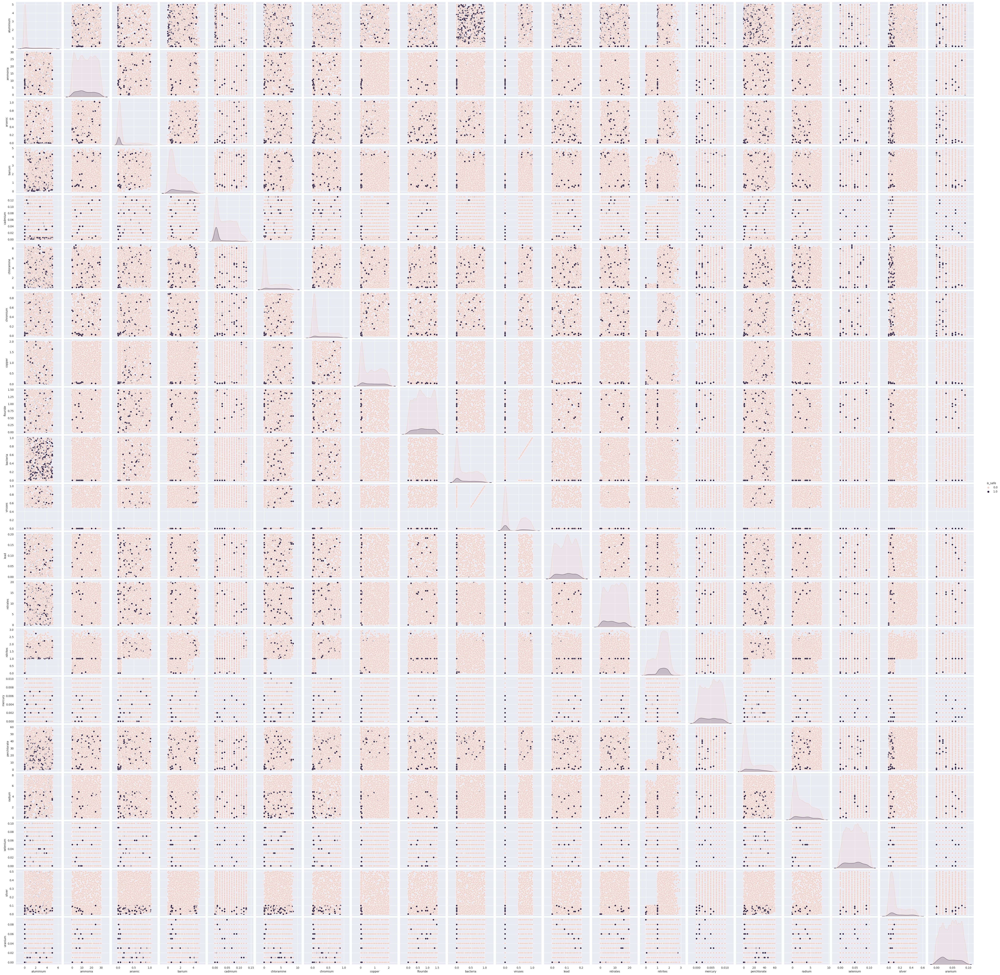

In [8]:
sns.pairplot(data = ds, hue = "is_safe")
pass

In [10]:
corrMatrix = ds.corr()
corrMatrix

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
aluminium,1.000000,0.067369,0.225773,0.294145,-0.099911,0.369309,0.353218,0.168612,-0.009784,-0.078238,...,0.020792,-0.003810,0.237307,-0.003306,0.363069,0.243217,-0.003672,0.334993,0.014711,0.333974
ammonia,0.067369,1.000000,0.046783,0.070099,-0.006422,0.104775,0.124782,0.015953,-0.028221,0.063603,...,-0.037065,0.006483,-0.063309,0.020884,0.090928,0.050401,0.029897,0.075547,0.014635,-0.022919
arsenic,0.225773,0.046783,1.000000,0.362945,0.334682,0.356559,0.312475,-0.036444,0.003792,0.035688,...,-0.087756,0.027554,0.305005,-0.015404,0.332279,0.218204,-0.007009,0.307837,0.001455,-0.123362
barium,0.294145,0.070099,0.362945,1.000000,-0.037803,0.446928,0.415972,0.065426,-0.018548,0.101259,...,-0.042888,-0.011331,0.312711,0.005987,0.462234,0.286569,0.035242,0.431606,-0.002440,0.090858
cadmium,-0.099911,-0.006422,0.334682,-0.037803,1.000000,-0.144370,-0.157766,-0.109024,0.004880,-0.092431,...,-0.034959,0.020194,-0.015682,-0.016174,-0.149344,-0.099259,0.010145,-0.155408,-0.005633,-0.256034
chloramine,0.369309,0.104775,0.356559,0.446928,-0.144370,1.000000,0.555938,0.119059,0.004400,0.154510,...,-0.030479,-0.001551,0.379685,-0.021472,0.588769,0.388806,0.011399,0.522447,-0.007658,0.186704
chromium,0.353218,0.124782,0.312475,0.415972,-0.157766,0.555938,1.000000,0.113043,-0.002284,0.142041,...,-0.050501,-0.012793,0.335708,-0.022787,0.524532,0.315271,0.030539,0.510768,-0.005526,0.182306
copper,0.168612,0.015953,-0.036444,0.065426,-0.109024,0.119059,0.113043,1.000000,0.011683,0.149110,...,0.121765,0.002332,0.162093,0.017626,0.104564,0.026215,-0.003267,0.089333,0.006978,0.029498
flouride,-0.009784,-0.028221,0.003792,-0.018548,0.004880,0.004400,-0.002284,0.011683,1.000000,0.014134,...,0.011905,-0.008140,-0.016669,-0.004400,-0.016191,0.007688,0.022629,0.014554,0.016792,0.006550
bacteria,-0.078238,0.063603,0.035688,0.101259,-0.092431,0.154510,0.142041,0.149110,0.014134,1.000000,...,-0.027525,-0.033920,0.246252,-0.004471,0.147652,0.099298,-0.006971,0.148225,0.044839,-0.022077


In [11]:
sns.heatmap(corrMatrix)
pass

In [12]:
ds.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7999 entries, 0 to 7998
Data columns (total 21 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   aluminium    7999 non-null   float64
 1   ammonia      7996 non-null   float64
 2   arsenic      7999 non-null   float64
 3   barium       7999 non-null   float64
 4   cadmium      7999 non-null   float64
 5   chloramine   7999 non-null   float64
 6   chromium     7999 non-null   float64
 7   copper       7999 non-null   float64
 8   flouride     7999 non-null   float64
 9   bacteria     7999 non-null   float64
 10  viruses      7999 non-null   float64
 11  lead         7999 non-null   float64
 12  nitrates     7999 non-null   float64
 13  nitrites     7999 non-null   float64
 14  mercury      7999 non-null   float64
 15  perchlorate  7999 non-null   float64
 16  radium       7999 non-null   float64
 17  selenium     7999 non-null   float64
 18  silver       7999 non-null   float64
 19  uraniu

In [30]:
def visualize(dataset):
    fig, ax = plt.subplots(4, 5, figsize = (10, 10))
    fig.suptitle('Распределения числовых признаков')
    cols = dataset.columns
    for i in range(20):
        sns.histplot(dataset[cols[i]], ax = ax[i // 5][i % 5], kde = True)
    pass

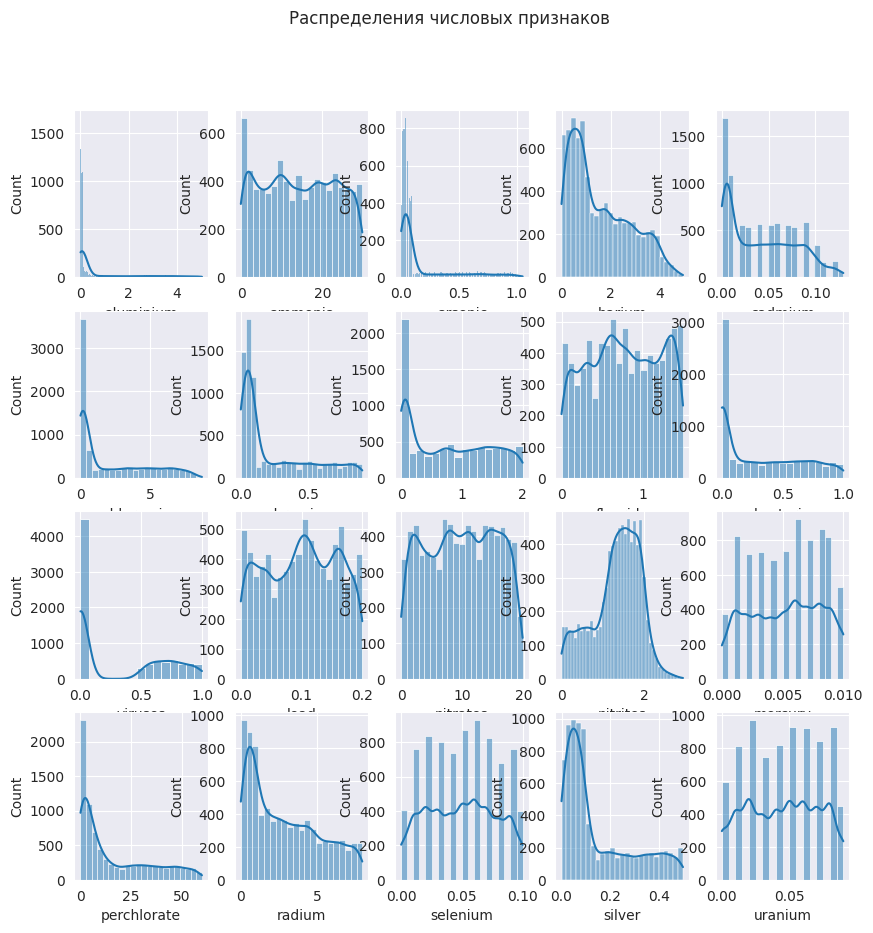

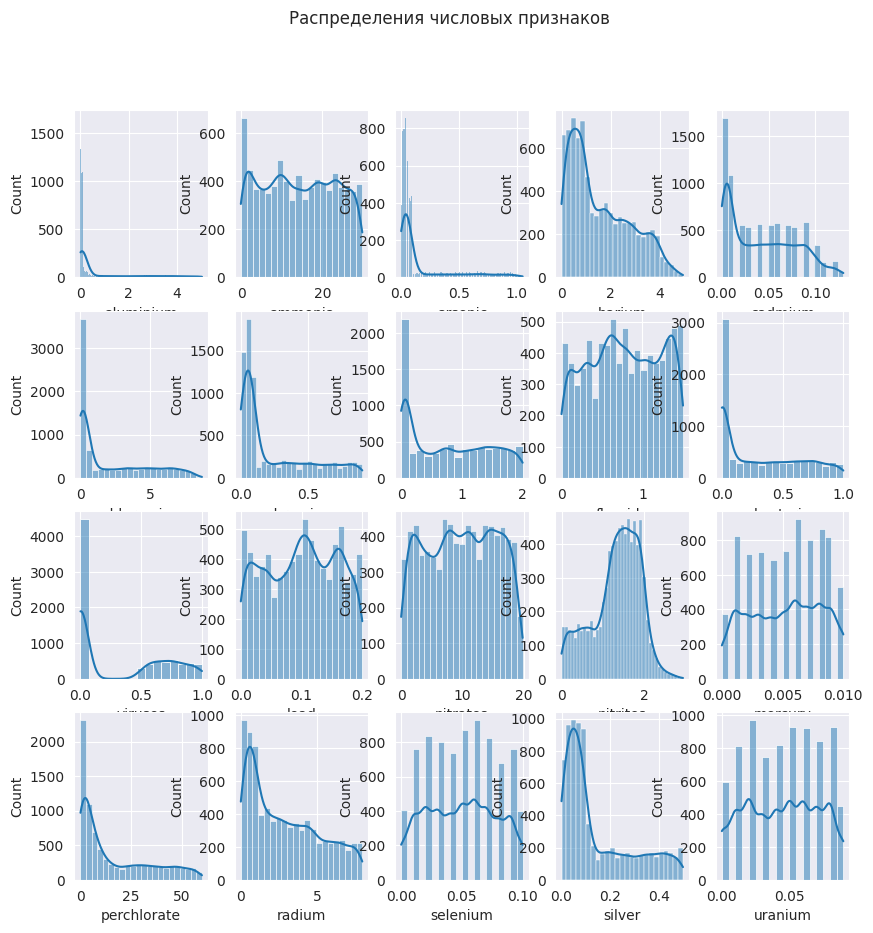

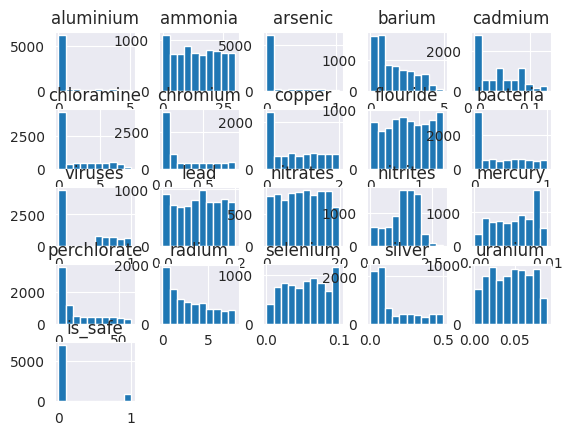

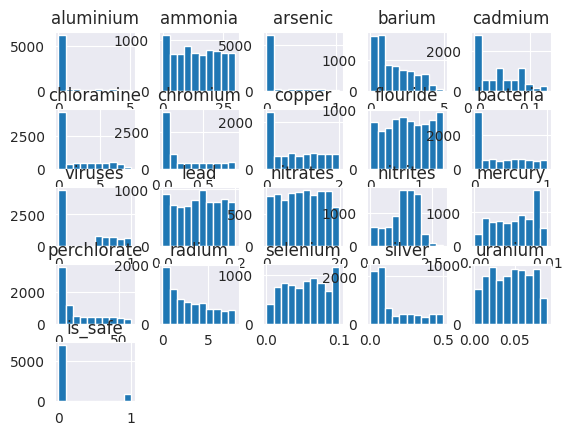

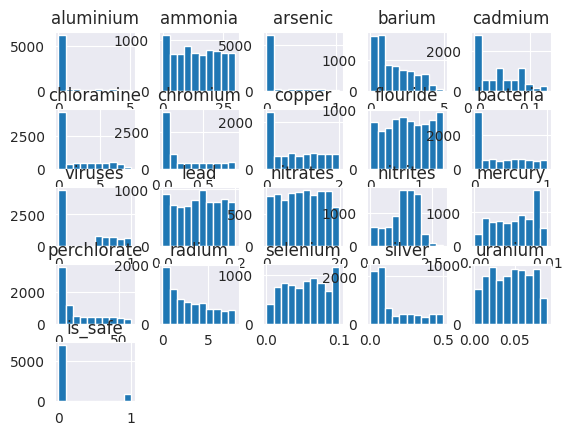

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [34]:
hist = ds.hist()
plt.show(hist)

In [26]:
sns.histplot(ds['aluminium'], kde=True)

<AxesSubplot:xlabel='uranium', ylabel='Count'>

Имеется небольшое количество выбросов у некоторых признаков. Удалю все данные, где Roundness < 0.5, Perimeter > 420 и Eccentricity < 0.85

In [15]:
ds = ds.loc[ds['Roundness'] >= 0.5]
ds = ds.loc[ds['Perimeter'] <= 420]
ds = ds.loc[ds['Eccentricity'] >= 0.85]


ds.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 17863 entries, 89 to 18184
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             17863 non-null  float64
 1   MajorAxisLength  17863 non-null  float64
 2   MinorAxisLength  17863 non-null  float64
 3   Eccentricity     17863 non-null  float64
 4   ConvexArea       17863 non-null  float64
 5   EquivDiameter    17863 non-null  float64
 6   Extent           17863 non-null  float64
 7   Perimeter        17863 non-null  float64
 8   Roundness        17863 non-null  float64
 9   AspectRation     17863 non-null  float64
 10  Class            17863 non-null  float64
dtypes: float64(11)
memory usage: 1.6 MB


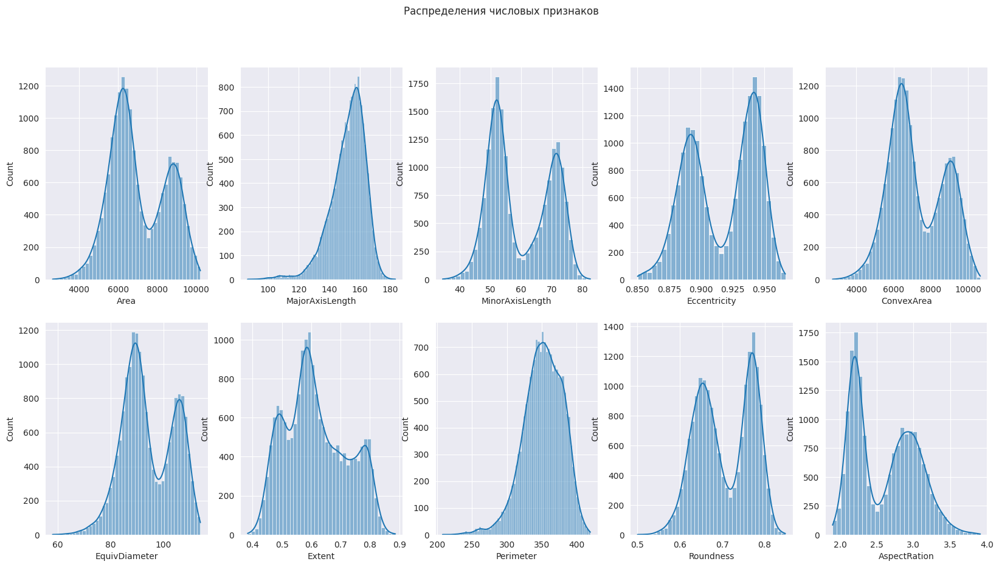

In [16]:
visualize(ds)

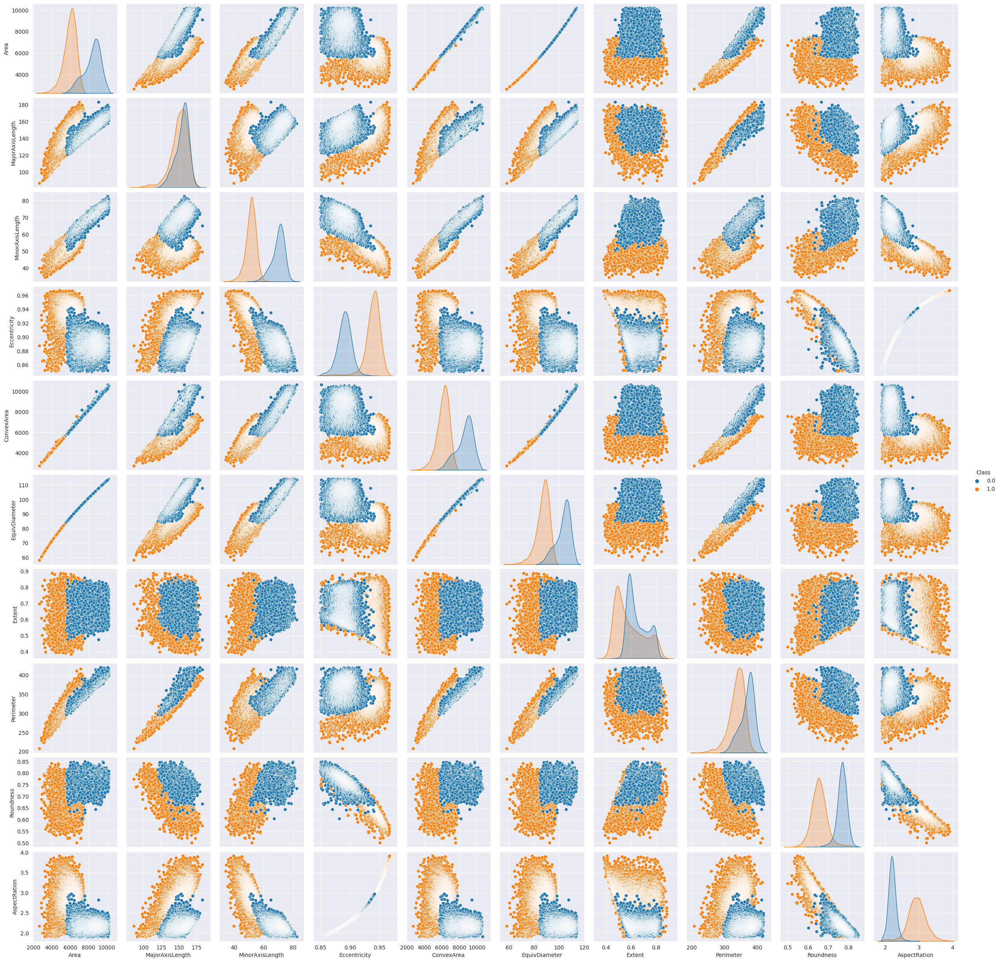

In [17]:
sns.pairplot(data = ds, hue = "Class")
pass

In [18]:
corrMatrix = ds.corr()
corrMatrix

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
Area,1.000000,0.601742,0.946355,-0.690969,0.999454,0.998405,0.241030,0.893676,0.676535,-0.682109,-0.826866
MajorAxisLength,0.601742,1.000000,0.318515,0.143127,0.604078,0.616866,-0.053514,0.873930,-0.138108,0.161874,-0.168496
MinorAxisLength,0.946355,0.318515,1.000000,-0.884381,0.945160,0.941803,0.306820,0.717363,0.858064,-0.877267,-0.917695
Eccentricity,-0.690969,0.143127,-0.884381,1.000000,-0.688548,-0.680375,-0.341642,-0.329682,-0.953128,0.978950,0.874632
ConvexArea,0.999454,0.604078,0.945160,-0.688548,1.000000,0.997779,0.238177,0.897703,0.668161,-0.679602,-0.824445
EquivDiameter,0.998405,0.616866,0.941803,-0.680375,0.997779,1.000000,0.237700,0.902336,0.666823,-0.672446,-0.820879
Extent,0.241030,-0.053514,0.306820,-0.341642,0.238177,0.237700,1.000000,0.096754,0.362806,-0.346367,-0.303015
Perimeter,0.893676,0.873930,0.717363,-0.329682,0.897703,0.902336,0.096754,1.000000,0.282013,-0.312820,-0.560906
Roundness,0.676535,-0.138108,0.858064,-0.953128,0.668161,0.666823,0.362806,0.282013,1.000000,-0.960270,-0.859173
AspectRation,-0.682109,0.161874,-0.877267,0.978950,-0.679602,-0.672446,-0.346367,-0.312820,-0.960270,1.000000,0.853185


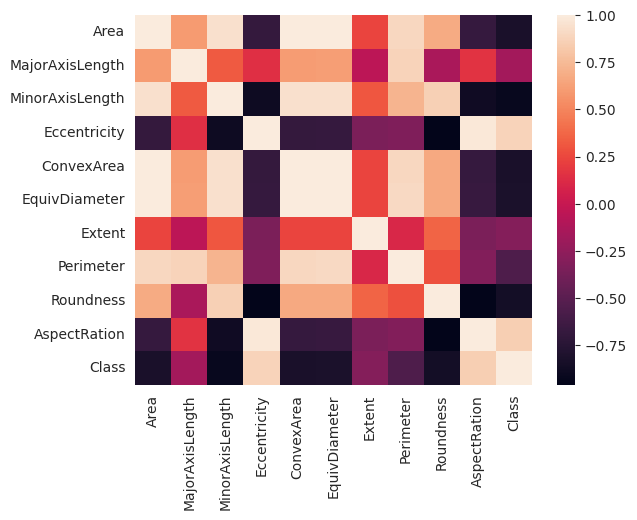

In [19]:
sns.heatmap(corrMatrix)
pass

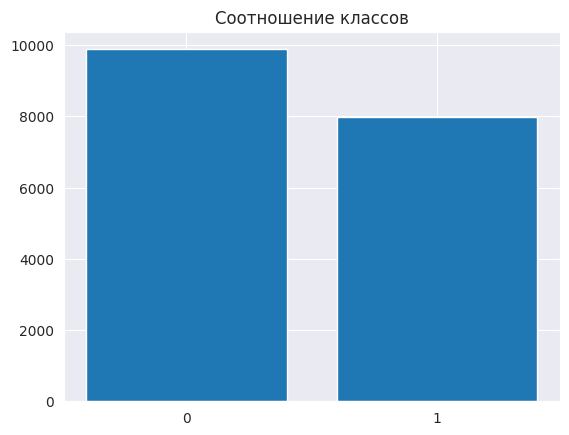

In [20]:
indexes = [0, 1]
cnts = ds['Class'].value_counts().values

plt.title("Соотношение классов")
plt.xticks(indexes)
plt.bar(indexes, cnts)
plt.show()

In [21]:
ds.to_csv('../data/out.csv')

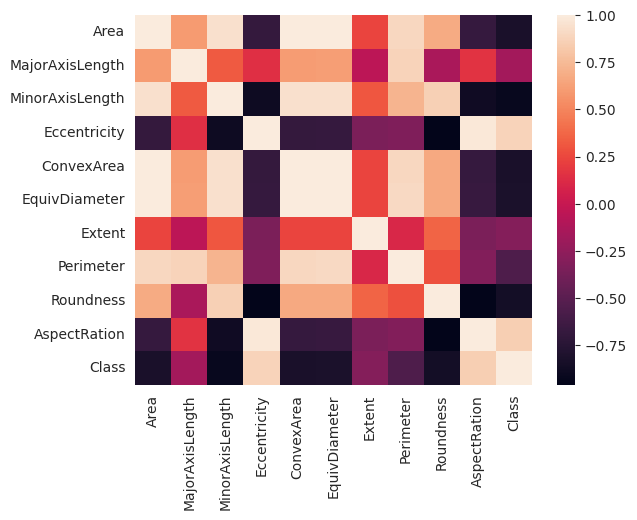

In [22]:
sns.heatmap(corrMatrix)
pass

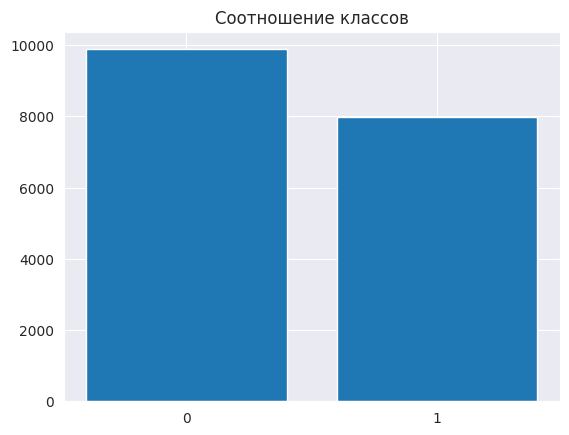

In [23]:
indexes = [0, 1]
cnts = ds['Class'].value_counts().values

plt.title("Соотношение классов")
plt.xticks(indexes)
plt.bar(indexes, cnts)
plt.show()

In [26]:
ds.to_csv('../data/out.csv', index=False)

In [25]:
ds.head()

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
89,4472.0,106.216259,55.861038,0.850535,4642.0,75.458116,0.775312,274.486,0.745884,1.901437,1.0
90,3951.0,100.022328,52.476331,0.851320,4085.0,70.926507,0.563784,253.792,0.770834,1.906047,1.0
91,4621.0,107.515859,56.390835,0.851418,4798.0,76.704889,0.658262,277.531,0.753916,1.906619,1.0
92,4709.0,107.830578,56.550030,0.851451,4801.0,77.431809,0.824405,265.248,0.841074,1.906817,1.0
93,4581.0,106.597203,55.874881,0.851615,4685.0,76.372183,0.565625,266.221,0.812242,1.907784,1.0
